In [1]:
#input path to your .csv from ICY
csv_path = '/home/noah/Documents/NoahT2022/Data/SingleCell_Tracking/ALI_comp/greenTracks.csv'

#input path to .avi of GCaMP Video
vid_path = '/home/noah/Documents/NoahT2022/Data/SingleCell_Tracking/ALI_comp/6X_G7_REST (2).avi'

#input path to .avi of tdTomato Video
red_vid_path = '/home/noah/Documents/NoahT2022/Data/SingleCell_Tracking/ALI_comp/6X_tdt_REST.avi'

In [2]:
#importing packages

import SCHyA as hy
import matplotlib.pyplot as plt
import scipy.cluster.hierarchy as shc
from sklearn.cluster import AgglomerativeClustering
import pandas as pd
import numpy as np
import seaborn as sns

2023-01-26 20:51:22.122916: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2 AVX AVX2 AVX_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-26 20:51:22.168142: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.


In [3]:
#reading in data
import skvideo.io as io
import pandas as pd
def Read_Data_DF(csv_path, vid_path, red_vid_path):
    positions = (pd.read_csv(csv_path,usecols=['TrackID','t','x','y']))
    vid = io.vread(vid_path)
    red_vid = io.vread(red_vid_path)
    return positions, vid, red_vid

positions, vid, red_vid = Read_Data_DF(csv_path, vid_path, red_vid_path)

In [4]:
#reshape the .csv into a more useable form
# posit = hy.reshaper(positions)

#run time = 25.5m (with prints)
#will need to reevaluate how this function runs

In [5]:
#making a faster reshaping function...
#reshaping the .csv to be analysed
def reshaper(positions):
    number_tracks = int(positions[len(positions)-1,0])
    position_reshaped = []
    for i in range(number_tracks):
        positions_track = []
        for j in range(len(positions)):
            if positions[j,0] == i:
                positions_track.append(positions[j,2:4])
        position_reshaped.append(positions_track)
    posit = np.asanyarray(position_reshaped)
    return posit


def Fast_reshaper(positions):
    number_tracks = int(positions[len(positions)-1,0])
    position_reshaped = []
    for i in range(number_tracks):
        positions_track = []
        for j in range(len(positions)): #major slow down here as is iterates the entire list every time - doesnt stop once track ID changes 
            if positions[j,0] == i:
                positions_track.append(positions[j,2:4])
        position_reshaped.append(positions_track)
    posit = np.asanyarray(position_reshaped)
    return posit

# import pandas as pd
# positionDF = pd.DataFrame(positions)

In [6]:
#examine dataframe

#print(positionDF.head)

#grouping:
trackIDs = positions.TrackID.unique()
grouped = positions.groupby(['TrackID'])

posit = np.asanyarray([grouped.get_group(neuron).loc[:, ['x', 'y']].values for neuron in trackIDs])

/tmp/ipykernel_333605/1403588576.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  posit = np.asanyarray([grouped.get_group(neuron).loc[:, ['x', 'y']].values for neuron in trackIDs])


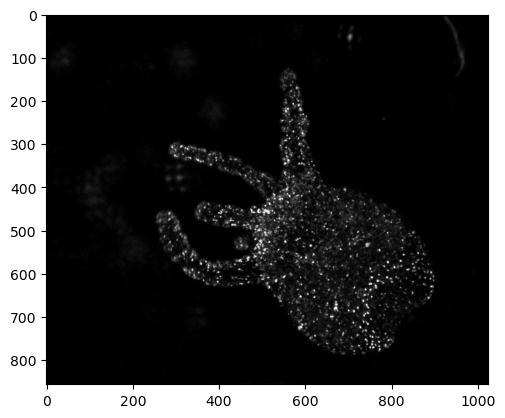

In [7]:
plt.imshow(red_vid[0])

In [8]:
#Get Information About Raw Data
num_frames = len(vid)
num_red_frames = len(red_vid)
num_tracks = len(posit)
#Display Information
print('Numer of Frames in Green Video:', num_frames)
print('Number of Frames in Red Video:', num_red_frames)
print('Number of Points Tracked by ICY:', num_tracks)

Numer of Frames in Green Video: 1000
Number of Frames in Red Video: 1000
Number of Points Tracked by ICY: 2743


In [9]:
#Discard Neurons which were incompletely tracked
posit_corrected = hy.remove_incomplete_tracks(posit, num_frames)

In [10]:
#Extract the fluorescence intensity in the GCaMP channel throughout the video for each neuron

#size of ROI
# dim = 9
dim=9
# subROI_Circle_size = 4
subROI_Circle_size = 4
LookBack = 4 #resistance of tracking to movement i.e. how quickly a tracked neuron can move before position resets

#Extract large ROI and remove points too close to edge
intensities_raw, posit_corrected_raw = hy.Extract_Fluorescence(posit_corrected, vid, dimention = dim)

#extract signal from subROI around neuron
intensities1, posit_corrected1, neuron_pts = hy.SingleCellIntensities(vid, posit_corrected_raw, dim, subROI_Circle_size, LookBack)

In [11]:
# %%capture

# #Investigating neuron 5
# # (neuron, video, positions, dimentionROI, Circle_radius, distance_threshold, display_on = False):
# _, _, _, display = hy.SingleCellIntensity(7,vid,posit_corrected_raw,9,4,4,True)

In [12]:
#extract position around the red track -> use MoCo -> Use ICA -> Evaluate performance

#Neuron 7 investigation: (5 also interesting)
neuron = 7

#ROI function (points = x,y coords of tracked point)
def ROIextractor(frame,points,dim):
    #why are these NOT already integers?? is it not pixel values?
    x = int(points[0])
    y = int(points[1])
    row1 = x - dim
    row2 = x + dim
    column1 = y - dim
    column2 = y + dim
    ROI = frame[column1:column2+1,row1:row2+1]
    return ROI

positions = posit_corrected_raw[neuron]
dimention = 12 #size of square ROI

ROI_Green = []
ROI_Red = []
for index, frame in enumerate(vid):
    ROI_Green.append(ROIextractor(frame, positions[index], dimention))
    ROI_Red.append(ROIextractor(red_vid[index], positions[index], dimention))

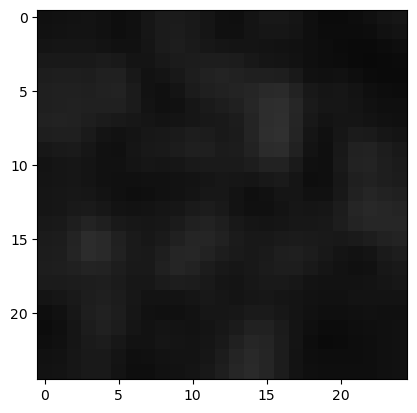

In [13]:
import matplotlib.animation as animation
import cv2
# %matplotlib tk
# plt.rcParams['animation.ffmpeg_path']=r"C:\ffmpeg\bin\ffmpeg.exe"
fig, ax = plt.subplots()

images = []
for i, frames in enumerate(ROI_Green):
    # image = cv2.cvtColor(frames, cv2.COLOR_BGR2GRAY) #BGR2GRAY breaks all absolute values of brightness - fuck
    image = cv2.GaussianBlur(frames, (5,5), 0)
    image = ax.imshow((image), animated=True)
    images.append([image])


ani = animation.ArtistAnimation(fig, images, interval=50, blit=True, repeat_delay=1000)

# writergif = animation.PillowWriter(fps=30)
# ani.save('n5_rawGreen.gif, writer=writervideo')

from IPython.display import HTML
HTML(ani.to_jshtml())

# plt.imshow(ROI[60])

In [14]:
# for i, frames in enumerate(ROI_Green):
#     title = r"C:\Users\rylab\Desktop\n5_rawGreen\frame" + str(i) + '.tif'
#     plt.imshow(frames)
#     plt.savefig(str(title), format = 'tif')



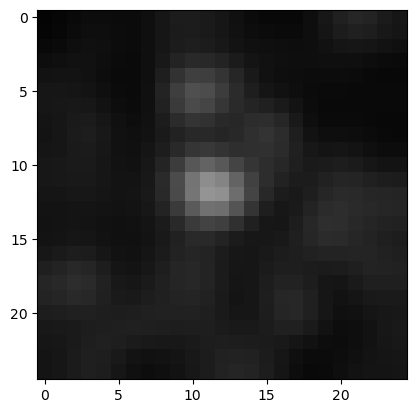

In [15]:
fig, ax = plt.subplots()

images = []
for i, frames in enumerate(ROI_Red):
    # image = cv2.cvtColor(frames, cv2.COLOR_BGR2GRAY) #BGR2GRAY breaks all absolute values of brightness - fuck
    image = cv2.GaussianBlur(frames, (5,5), 0)
    image = ax.imshow((image), animated=True)
    images.append([image])


ani = animation.ArtistAnimation(fig, images, interval=50, blit=True, repeat_delay=1000)

# ani.save('n5_rawRed.avi')
from IPython.display import HTML
HTML(ani.to_jshtml())

In [16]:
#looks like brightness is not normalised across all images - ie the brightest point in each frame always appears the same colour 
#regardless of whether it is actually a bright point in the movie as a whole

Normalize = []
for frame in ROI_Green:
    im = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    # im = cv2.GaussianBlur(im, (5,5), 0) #experimental
    Normalize.append(im)

arrayForm = np.asanyarray(Normalize)
array = np.array(arrayForm) #should specify somewhere that dtype = object :)


In [17]:
#motion correction!
from caiman.base import movies as mov
from caiman.motion_correction import MotionCorrect, tile_and_correct, motion_correction_piecewise

Time_downsampling_Ratio = 0.5
movie_original = mov.movie(array, fr = 10)
# movie_original.resize(1, 1, Time_downsampling_Ratio).play(q_max=99.5, fr=30, magnification=2)
movie_original.resize(1, 1, Time_downsampling_Ratio).play(q_max=99.5, fr=100, magnification=8, do_loop = False, save_movie = False, opencv_codec = '8bpp', movie_name = 'n5_notcorrected.BMP')
#q to exit


inotify_add_watch(/home/noah/.config/ibus/bus/03e5d54b850946f2862d3116726dad80-unix-0) failed: (No space left on device)


In [18]:
# fourcc = cv2.VideoWriter_fourcc(*'XVID')
# frame_in = movie_original[0]
# movie_name = 'n5_uncorrected.avi'
# magnification = 1
# out = cv2.VideoWriter(movie_name, fourcc, 30.,tuple([int(magnification * s) for s in frame_in.shape[1::-1]]))

In [19]:
#Actually Correct Motion

max_shifts = (6, 6)  # maximum allowed rigid shift in pixels (view the movie to get a sense of motion)
strides =  (6, 6)  # create a new patch every x pixels for pw-rigid correction
overlaps = (5, 5)  # overlap between pathes (size of patch strides+overlaps)
max_deviation_rigid = 5   # maximum deviation allowed for patch with respect to rigid shifts
pw_rigid = True  # flag for performing rigid or piecewise rigid motion correction
shifts_opencv = True  # flag for correcting motion using bicubic interpolation (otherwise FFT interpolation is used)
border_nan = 'copy'  # replicate values along the boundary (if True, fill in with NaN)

mc = MotionCorrect(array, max_shifts=max_shifts, strides=strides, overlaps=overlaps, max_deviation_rigid=max_deviation_rigid, shifts_opencv=shifts_opencv, nonneg_movie=True, border_nan=border_nan)



In [20]:
#ACTUALLY  actually motion correct
mc.pw_rigid = True
mc.is3D = False
mc.motion_correct(save_movie=True)

In [21]:
m_els = mov.load(mc.fname_tot_els)

# m_els.resize(1, 1, Time_downsampling_Ratio).play(q_max=99.5, fr=100, magnification=8, do_loop = True)
m_els.resize(1, 1, Time_downsampling_Ratio).play(q_max=99.9, fr=100, magnification=6, do_loop = False, save_movie = False, opencv_codec = '8bpp', movie_name = 'n5_NormCorr4.BMP')

100%|██████████| 1/1 [00:00<00:00, 1098.27it/s]


Decode mmap filename tmp_mov_mot_corr_els__d1_25_d2_25_d3_1_order_F_frames_1000.mmap


In [22]:
# fourCC codes for saving videos:
#   MJPG lossy avi
#   FFV1 (lossless ffmpeg)
#   'DIB ' (lossless?)
#   8bpp for individual images (also 4bpp, 16bpp etc)

In [70]:
# use ica for source extraction
from caiman.source_extraction import cnmf
import caiman as cm

n_processes = 1
expected_neurons = 4
neuronSize = (dim, dim)
cnm = cnmf.CNMF(n_processes=n_processes, k = expected_neurons, gSig = neuronSize)

In [71]:
fname_mc = mc.fname_tot_els
fname_new = cm.save_memmap(fname_mc, base_name='memmap_', order='C')
Yr, dims, T = cm.load_memmap(fname_new)
images = Yr.T.reshape((T,) + dims, order='F')

Decode mmap filename tmp_mov_mot_corr_els__d1_25_d2_25_d3_1_order_F_frames_1000.mmap
Decode mmap filename memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap


In [72]:
cnm.fit(images)

The number of pixels per process (n_pixels_per_process) is larger than the total number of pixels!! Decreasing suitably.
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_25_d2_25_d3_1_order_C_frames_1000.mmap
Decode mmap filename /home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/memmap_d1_2

In [74]:
cnm.estimates.play_movie(images, q_max=99.9, magnification=12, include_bck=True, gain_res=8)

movie([[[ 2.06083775e+01,  9.68092060e+00,  1.19573488e+01, ...,
          1.04738602e+02,  1.13926638e+02,  1.12120946e+02],
        [ 2.44414482e+01, -3.36031055e+00,  6.82107973e+00, ...,
         -6.18715822e+01, -5.71204788e+01, -6.01607703e+01],
        [ 1.88832760e+01,  1.50931540e+01,  2.04490643e+01, ...,
          1.55708421e+02,  1.57829371e+02,  1.52536207e+02],
        ...,
        [ 2.52119675e+01,  2.52119675e+01,  2.51340427e+01, ...,
          4.49045000e+01,  8.61312397e+01,  1.09695447e+02],
        [ 7.45720768e+00,  7.45720768e+00,  5.86163092e+00, ...,
          2.35462386e+02, -6.09140994e+01, -1.32535050e+02],
        [ 5.94139934e-01,  5.94139934e-01, -2.33698177e+00, ...,
          2.54063523e+02,  2.06406467e+02,  1.28140594e+02]],

       [[ 2.35099258e+01, -1.61220479e+00,  5.43833256e+00, ...,
         -1.22736843e+02, -1.14396098e+02, -1.16035276e+02],
        [ 2.03516006e+01, -1.48096168e+00,  3.99506688e+00, ...,
          4.58273563e+01,  5.03558811e

In [27]:
#green Tracks inclusion
green_trackPath = '/home/noah/Documents/NoahT2022/Data/SingleCell_Tracking/ALI_comp/greenTracks.csv'
positionsGreenTracks = (pd.read_csv(green_trackPath, usecols=['TrackID','t','x','y'])).values

In [28]:
positGreen = hy.reshaper(positionsGreenTracks)

/home/noah/Documents/NoahT2022/CodeRepos/SingleCell_analysis/SCHyA.py:224: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  posit = np.asanyarray(position_reshaped)


In [29]:
num_tracks_green = len(positGreen)
print('num green tracks: ', (num_tracks_green))

num green tracks:  2742


In [30]:
positGreen_corrected = hy.remove_incomplete_tracks(positGreen, num_frames)

In [31]:
print('number of corrected green tracks: ', len(positGreen_corrected))
print('number of crorrected red tracks: ', len(posit_corrected))

number of corrected green tracks:  314
number of crorrected red tracks:  314


In [32]:
# positGreen_corrected[0]

In [33]:
ROI_Green2 = []
for index, frame in enumerate(vid):
    ROI_Green2.append(ROIextractor(frame, positGreen_corrected[5][index], 12))

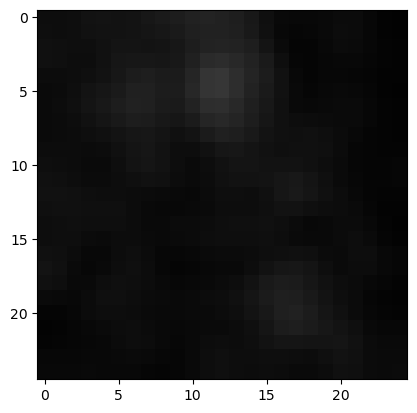

In [34]:
fig, ax = plt.subplots()

images = []
for i, frames in enumerate(ROI_Green2):
    # image = cv2.cvtColor(frames, cv2.COLOR_BGR2GRAY) #BGR2GRAY breaks all absolute values of brightness - fuck
    image = cv2.GaussianBlur(frames, (5,5), 0)
    image = ax.imshow((image), animated=True)
    images.append([image])


ani = animation.ArtistAnimation(fig, images, interval=50, blit=True, repeat_delay=1000)

# ani.save('n5_rawRed.avi')
from IPython.display import HTML
HTML(ani.to_jshtml())

In [35]:

np.array_equal(positGreen[0], posit[0])

True

[878.5    610.8125]
[878.5    610.8125]
[878.5    610.8125]


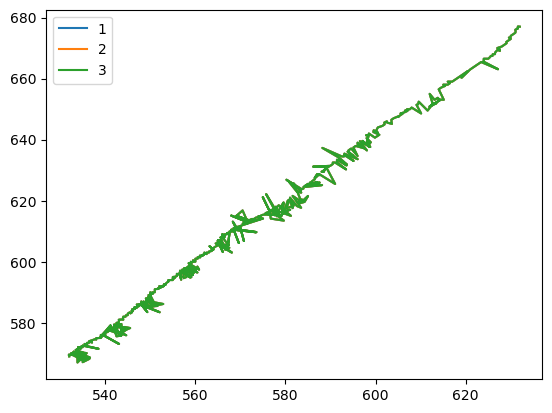

In [36]:
print(positGreen_corrected[5][1])
print(posit_corrected_raw[5][1])
print(posit_corrected1[5][1])


def xy_coords(neuronPosits):
    xCoords = [position[0] for position in neuronPosits]
    yCoords = [position[1] for position in neuronPosits]
    return xCoords, yCoords

positionNeuron = 7
Xs, Ys = xy_coords(positGreen_corrected[positionNeuron])
redXs, redYs = xy_coords(posit_corrected_raw[positionNeuron])
redXs1, redYs1 = xy_coords(posit_corrected1[positionNeuron])

plt.plot(Xs, Ys, label="1")
plt.plot(redXs, redYs, label="2")
plt.plot(redXs1, redYs1, label="3")
plt.legend()
plt.show()

KeyboardInterrupt: 

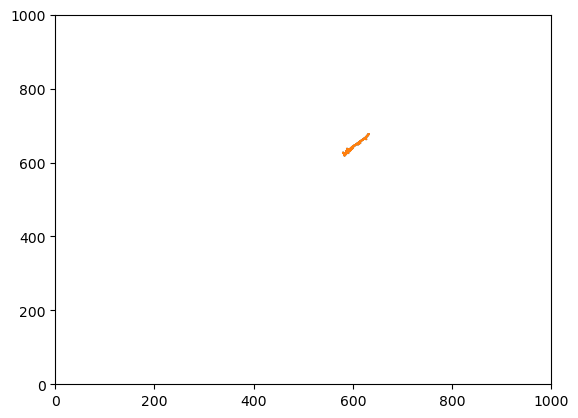

In [37]:
# neuron 7 plot position in red and green

import matplotlib
from matplotlib.animation import FuncAnimation
matplotlib.rcParams['animation.embed_limit'] = 2**128

x = []
y = []
redx = []
redy = []

# fig, ax = plt.subplots()


# ax.set_xlabel('X(t)')
# ax.set_ylabel('Y(t)')
# ax.set_title('Paths of Neuron 7')

# # line = ax.plot(Xs, Ys)

fig, ax = plt.subplots()
def animate(i):
    
    x.append(Xs[i])
    y.append(Ys[i])

    redx.append(redXs1[i])
    redy.append(redYs1[i])

    ax.clear()
    ax.plot(x, y)
    ax.plot(redx, redy)
    ax.set_xlim([0,1000])
    ax.set_ylim([0,1000])



## Create the animation object
# fig = plt.figure()
ani = FuncAnimation(fig, animate, frames=1000, interval=10, repeat=False)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [ ]:
#linking green and red tracks in hydra